# **TRANSFERÊNCIA DE ESTILO NEURAL**

Introduzido por Leon Gatys et al. Em 2015, em seu artigo intitulado “Um algoritmo neural para estilo artístico (https://arxiv.org/abs/1508.06576)”, o algoritmo de transferência de estilo neural se tornou viral, resultando em uma explosão de novos aplicativos de trabalho e móveis.

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/NST.png)

O Neural Style Transfer (NST) é uma técnica de inteligência artificial que combina o conteúdo de uma imagem com o estilo artístico de outra, criando uma nova imagem sintetizada. Desenvolvida inicialmente em 2015 por Gatys et al., a técnica utiliza redes neurais convolucionais (CNNs) para extrair características visuais de duas imagens distintas e fundi-las de forma harmoniosa. Recursos Computacionais: O método original de Gatys é lento (minutos/horas por imagem).

A técnica se baseia em redes neurais pré-treinadas para reconhecimento de objetos (ex: VGG19). A ideia central é que camadas diferentes da rede capturam informações diferentes:

- Camadas inferiores: Detectam bordas, cores e texturas simples (úteis para estilo).

- Camadas superiores: Capturam características complexas, como objetos ou estruturas (úteis para conteúdo).

1. Definição das Imagens:

    - Imagem de Conteúdo (C): A imagem que fornece a estrutura (ex: uma foto).

    - Imagem de Estilo (S): A imagem que fornece o estilo artístico (ex: uma pintura).

    - Imagem Gerada (G): A imagem inicial (geralmente ruído ou cópia de C) que será otimizada.

2. Extração de Características:

    - A rede neural processa as três imagens (C, S, G) e extrai ativações de camadas específicas
    
    - Camadas de Conteúdo: Normalmente camadas intermediárias (ex: conv4_2 no VGG19)

    - Camadas de Estilo: Múltiplas camadas (ex: conv1_1, conv2_1, conv3_1, etc.) para capturar texturas em diferentes escalas.

3. Cálculo das Funções de Perda:

    - Perda de Conteúdo (Content Loss): Mede a diferença entre as ativações da imagem gerada (G) e da imagem de conteúdo (C) nas camadas de     conteúdo.

    - Perda de Estilo (Style Loss): Usa a matriz de Gram (que captura correlações entre filtros da CNN) para representar texturas. Compara as matrizes de Gram das imagens de estilo (S) e gerada (G) em múltiplas camadas.

    - Perda Total: Combina as duas perdas com pesos alfa e beta.

4. Otimização:

    - Usa algoritmos como gradiente descendente para ajustar os pixels de G, minimizando perda total

    - A imagem gerada é atualizada iterativamente até convergir para um equilíbrio entre estilo e conteúdo.


# Variações e Melhorias

Transferência em Tempo Real: Técnicas como Fast Neural Style Transfer usam redes treinadas para aplicar estilos instantaneamente.

Controle de Estilo: Permitir ajustar a intensidade do estilo ou combinar múltiplos estilos.

Arquiteturas Alternativas: Uso de GANs (Redes Generativas Adversariais) para resultados mais realistas.

In [1]:
import cv2
import numpy as np
import time
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt

In [2]:
# Define our imshow function 
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio,size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

1 Usando modelo: candy


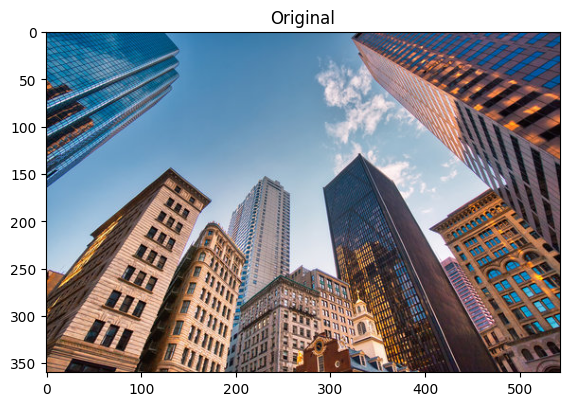

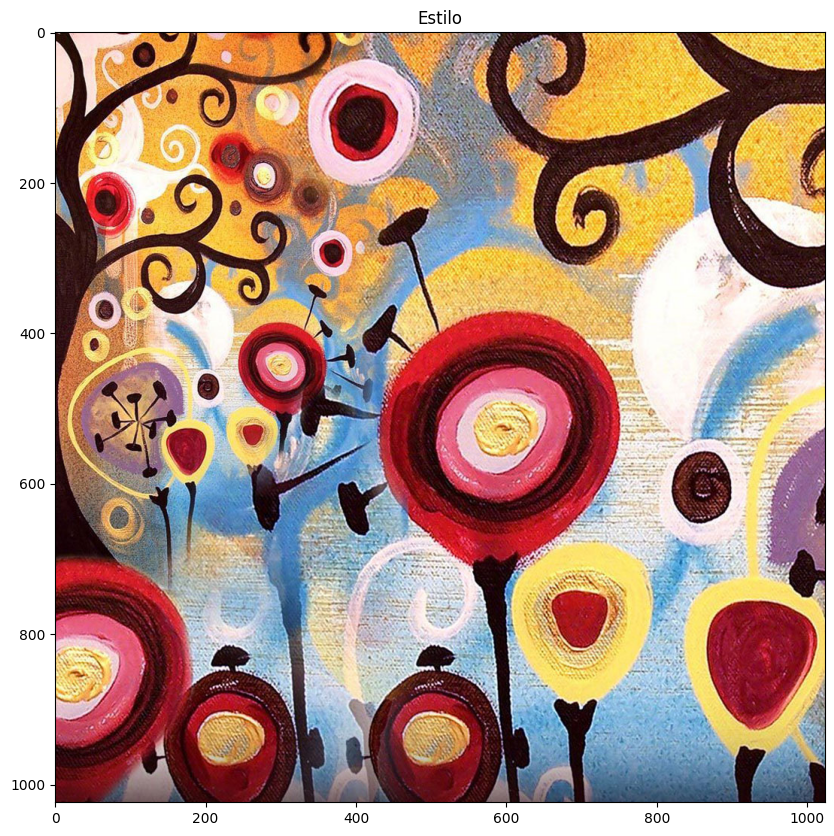

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14932948..1.0659193].


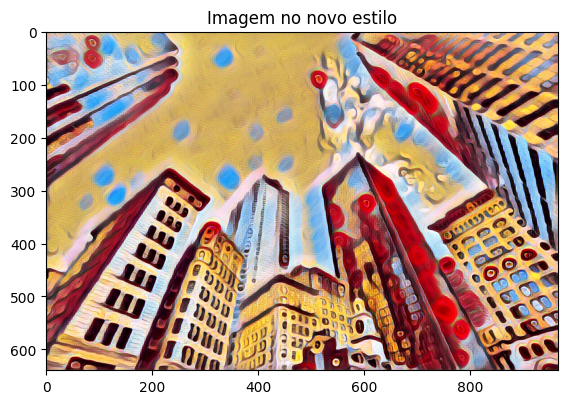

2 Usando modelo: composition_vii


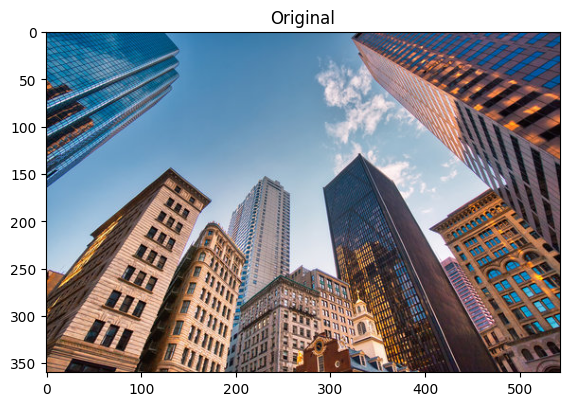

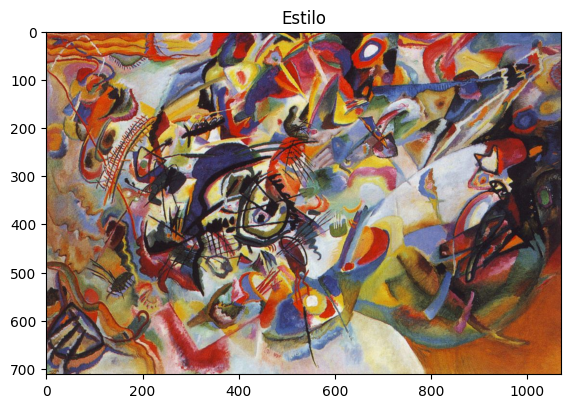

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16765271..1.0688438].


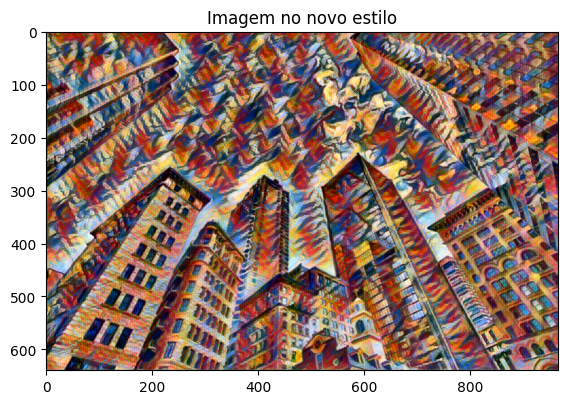

3 Usando modelo: feathers


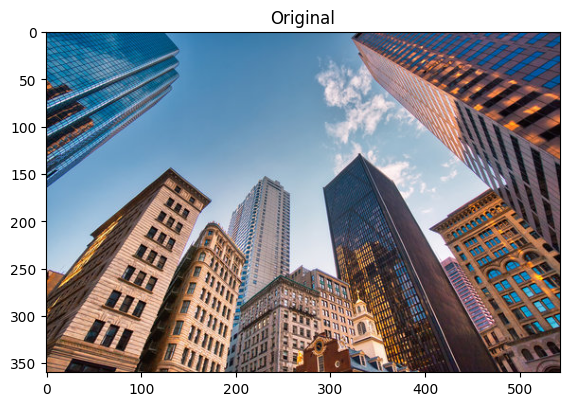

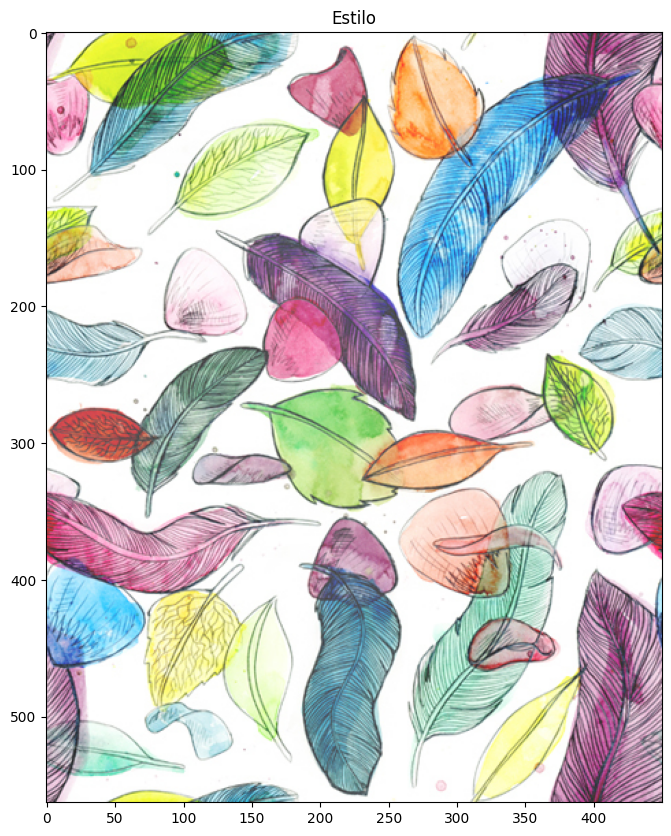

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14193615..1.0731773].


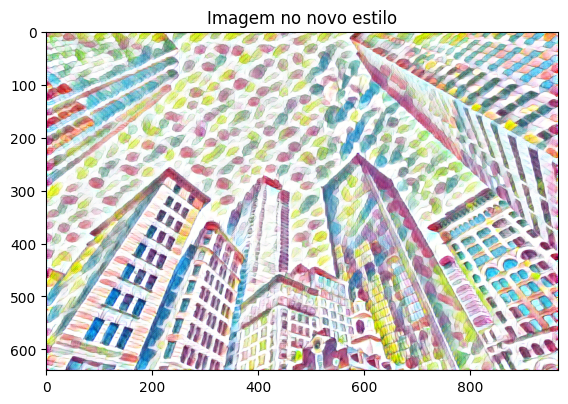

4 Usando modelo: la_muse


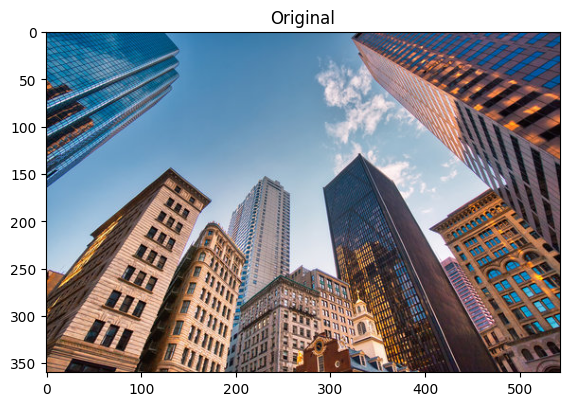

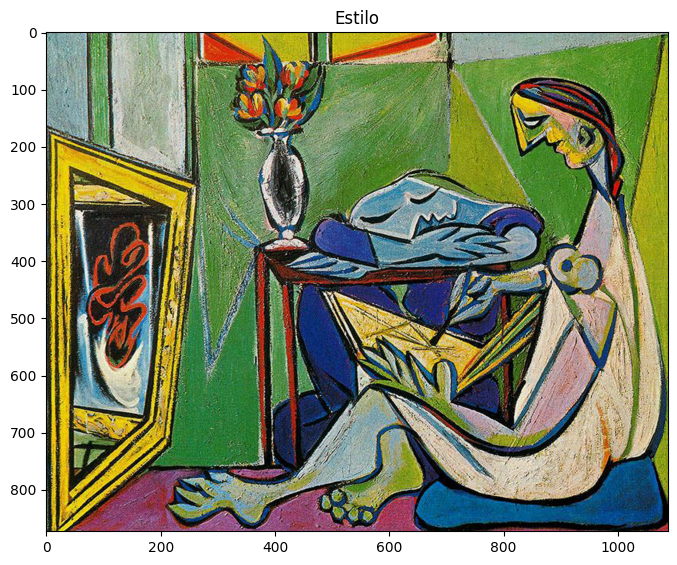

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17840406..1.0720849].


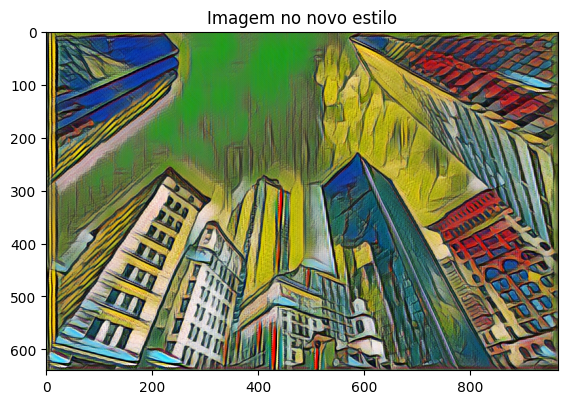

5 Usando modelo: mosaic


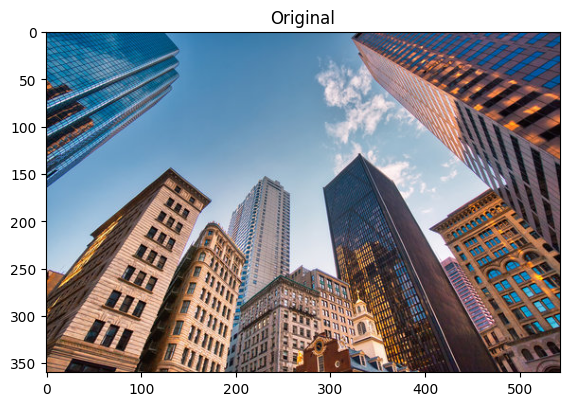

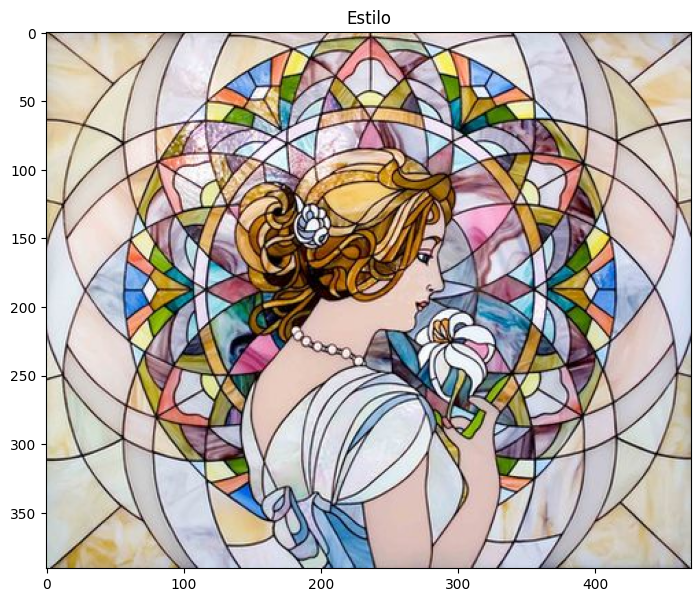

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15076429..1.0489208].


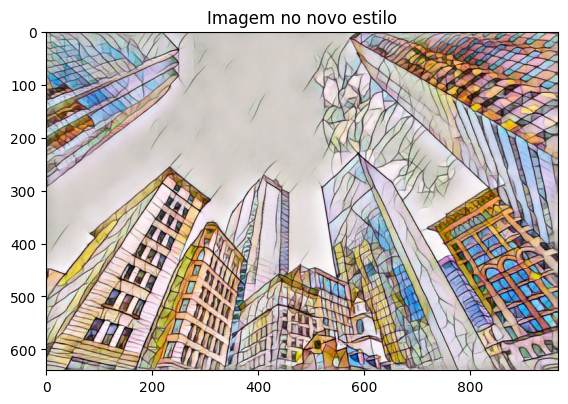

6 Usando modelo: starry_night


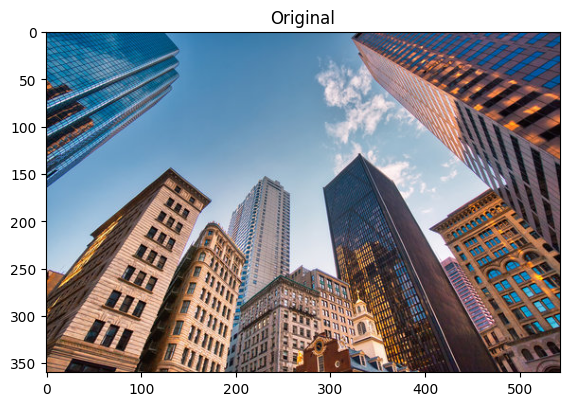

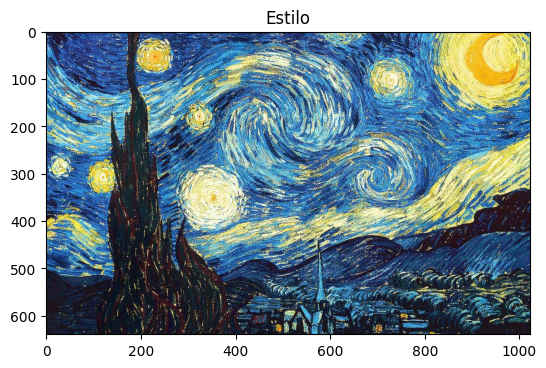

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08010658..1.0670824].


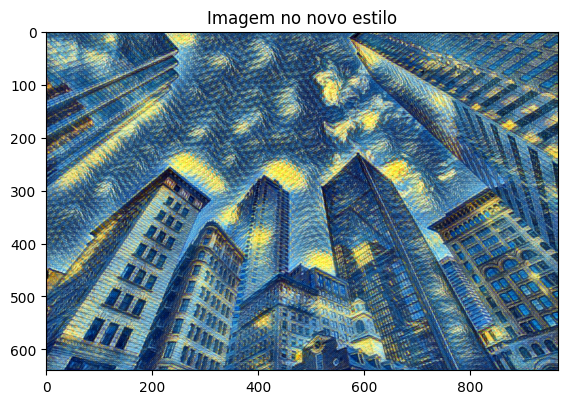

7 Usando modelo: the_scream


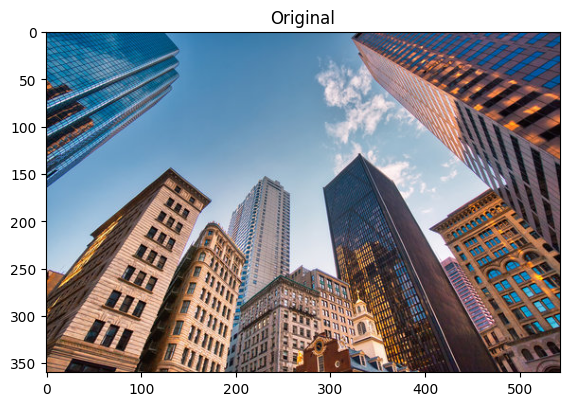

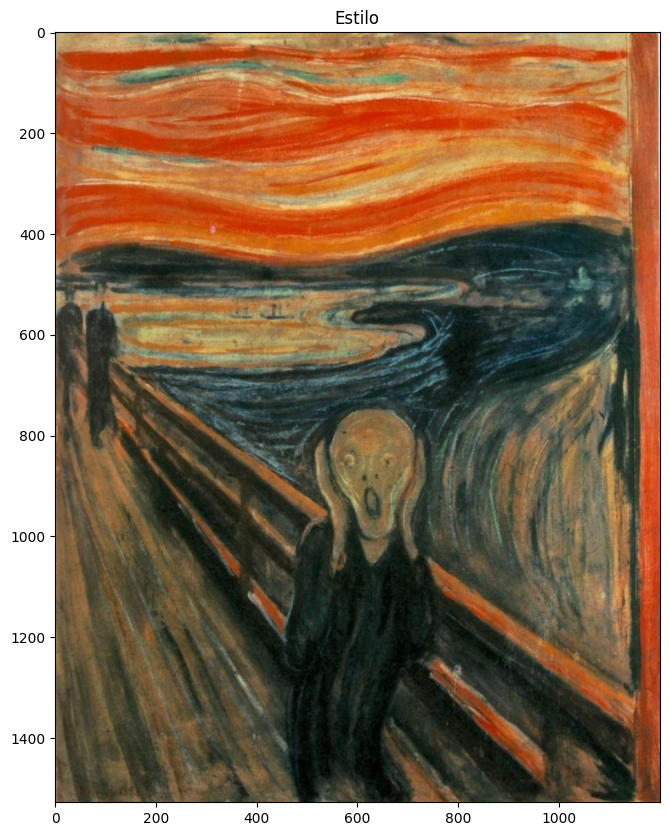

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11868516..1.0217289].


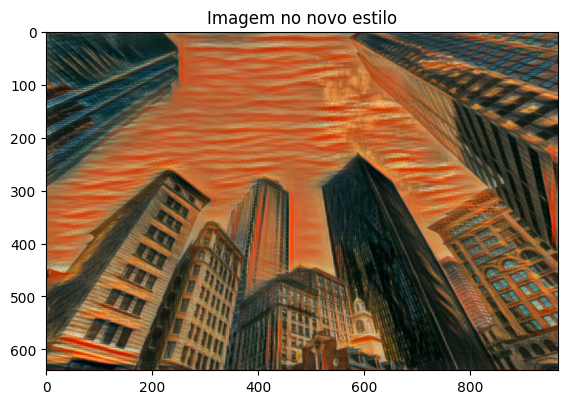

8 Usando modelo: the_wave


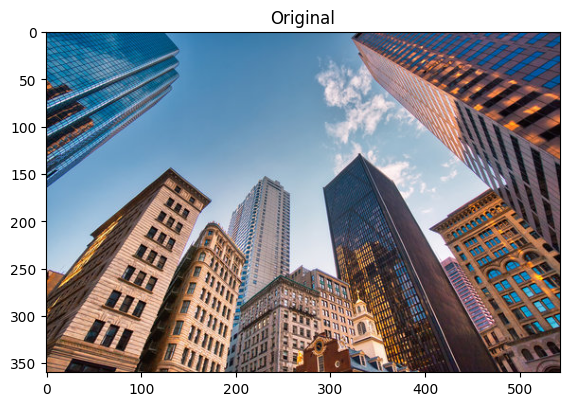

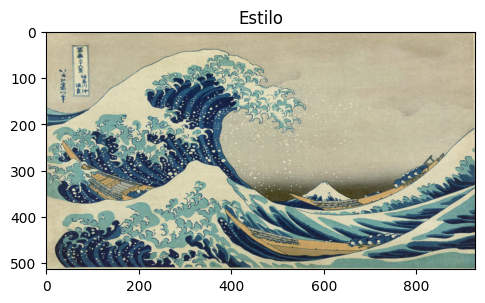

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.040526655..1.0731583].


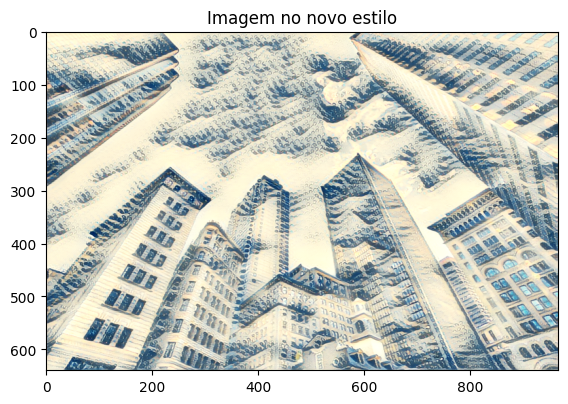

9 Usando modelo: udnie


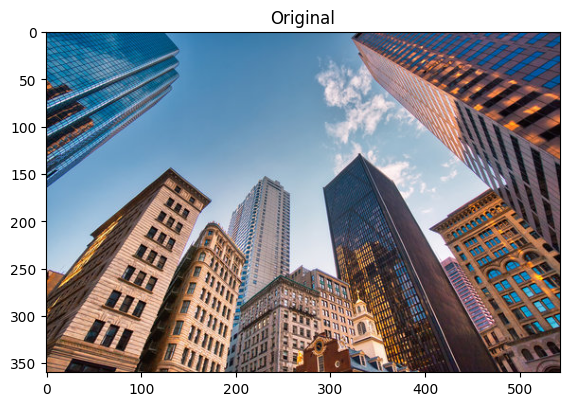

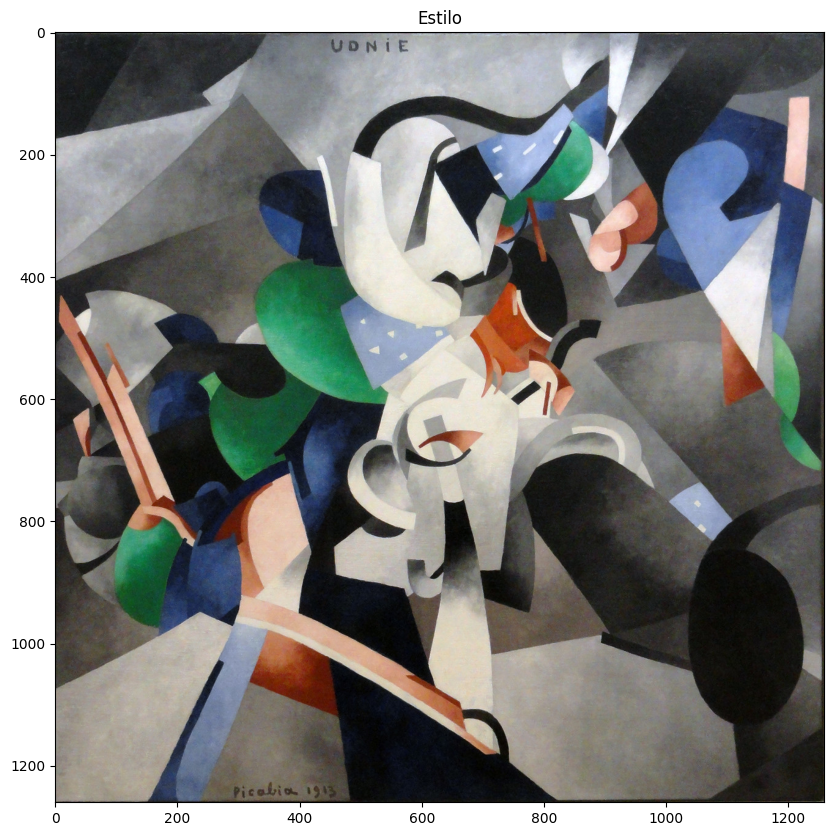

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15778877..1.0578264].


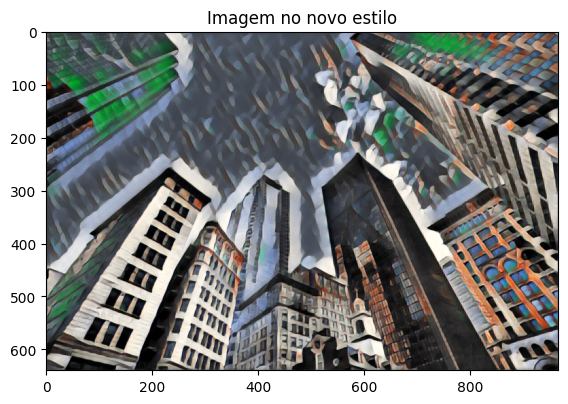

In [3]:
#Carregar modelos treinados https://github.com/Walid-Ahmed/Neural-Style-Transfer-with-TF/tree/master

caminho = 'models/modelsGatys/'
caminhoModelos = [f for f in listdir(caminho) if isfile(join(caminho, f))]


imagem = cv2.imread('imagens/cidade.jpg')

for (item, nomeModelo) in enumerate(caminhoModelos):

    print(str(item+1) + " Usando modelo: " + str(nomeModelo)[:-3])

    estilo = cv2.imread('art/'+str(nomeModelo)[:-3]+".jpg")

    modelo = cv2.dnn.readNetFromTorch(caminho+nomeModelo)

    altura, largura = imagem.shape[0], imagem.shape[1]

    novaLargura = int((640/altura) * largura) #Mudando o aspect ratio para a altura fixa de 640

    imagemAlterada = cv2.resize(imagem, (novaLargura, 640), interpolation=cv2.INTER_AREA)

    #criando imagem blob

    """
    A rede foi treinada com imagens normalizadas (valores centrados em zero).
    A subtração remove o "viés" das cores originais, facilitando o aprendizado de padrões.
    """
    blob = cv2.dnn.blobFromImage(imagemAlterada, 1.0, (novaLargura, 640), 
                                 (103.939, 116.779, 123.680), swapRB=False, crop=False)
    
    modelo.setInput(blob)

    saida = modelo.forward()

    #Devido ao parametro mean do blob, a gente vai adicionar de volta os valores e reordenar os canais

    saida = saida.reshape(3, saida.shape[2], saida.shape[3])
    saida[0] += 103.939
    saida[1] += 116.779
    saida[2] += 123.680
    saida /= 255 #Normalizando os valores para [0, 1]

    saida = saida.transpose(1, 2, 0) #Reordenando os canais

    imshow("Original", imagem)
    imshow("Estilo", estilo)
    imshow("Imagem no novo estilo", saida)

## Using the ECCV16 Updated NST Algorithm

O algoritmo ECCV16 Updated Neural Style Transfer (NST) refere-se a uma versão aprimorada do método original de transferência de estilo neural, apresentado na conferência European Conference on Computer Vision (ECCV) 2016. Essa atualização trouxe melhorias significativas em velocidade, qualidade e flexibilidade, tornando o processo mais eficiente e aplicável em cenários práticos. 

Artigo-chave: "Instance Normalization: The Missing Ingredient for Fast Stylization" (Ulyanov et al., ECCV 2016) https://arxiv.org/abs/1607.08022.

Vamos explorar seus detalhes:

- Inferência em Tempo Real: Utiliza uma rede neural treinada para gerar resultados instantaneamente.

- Arquitetura Otimizada: Incorpora técnicas como Instance Normalization e decoders eficientes.

- Multiplos Estilos: Permite combinar vários estilos ou ajustar sua intensidade.


Uso de Rede Generativa (Feed-Forward Network)

- Encoder-Decoder: Uma rede pré-treinada (ex: VGG16) extrai características, e um decoder as reconstrói com o estilo aplicado.

- Treinamento Offline: A rede é treinada para mapear qualquer imagem de conteúdo para um estilo específico, eliminando a necessidade de otimização durante a inferência.

Uso de Técnica de normalização que ajusta a média e o desvio padrão de cada imagem individualmente (em contraste com Batch Normalization, que usa estatísticas do lote).

Funções de perda calculadas durante treinamento, e não durante a inferência.

1 Usando modelo: composition_vii


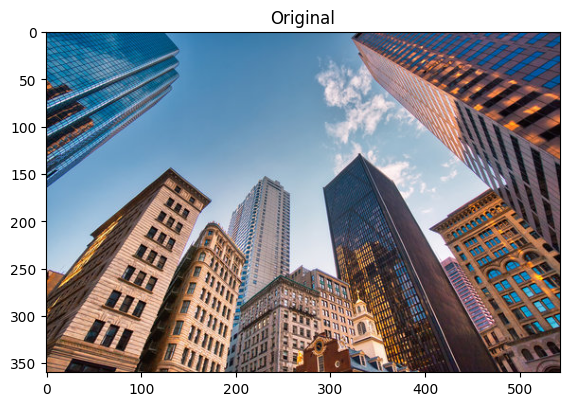

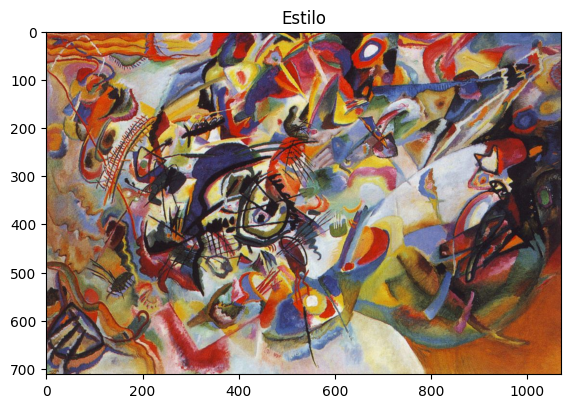

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16765271..1.0688438].


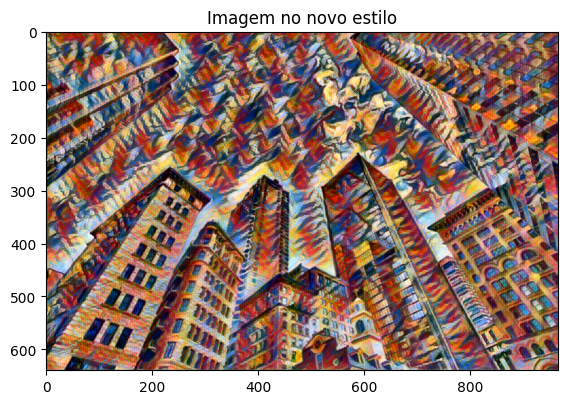

2 Usando modelo: la_muse


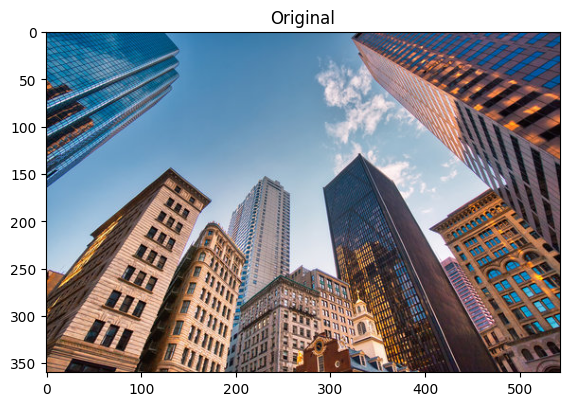

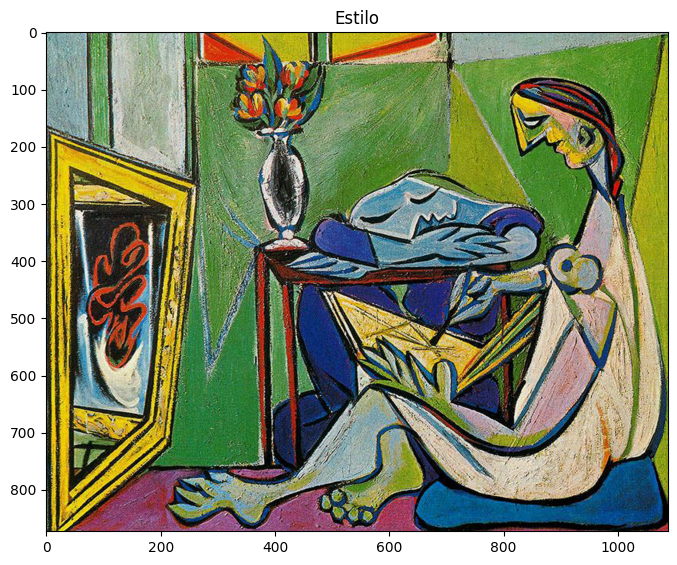

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17840406..1.0720849].


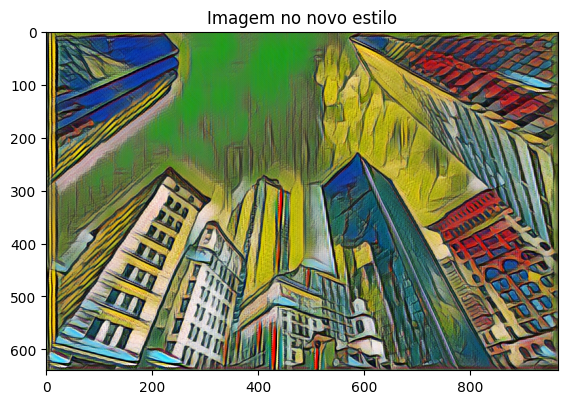

3 Usando modelo: starry_night


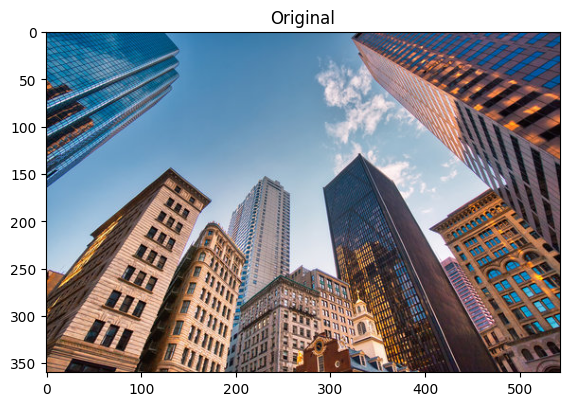

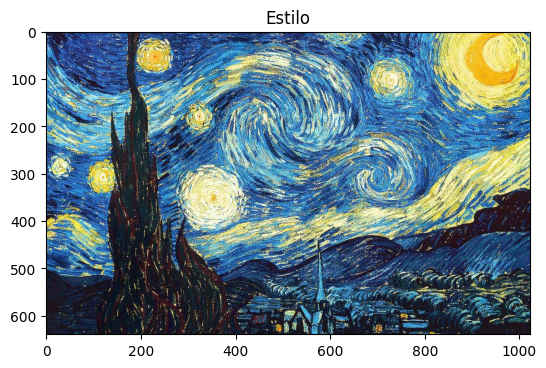

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1691364..1.0731966].


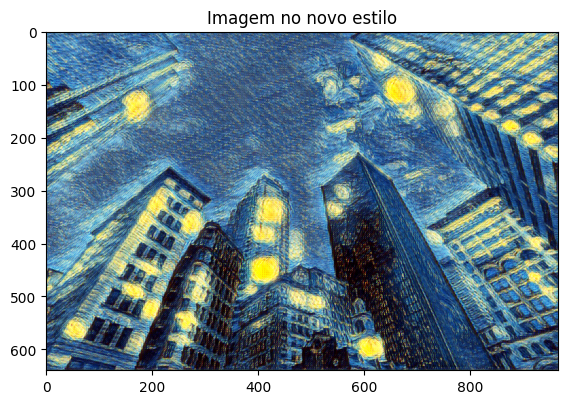

4 Usando modelo: the_wave


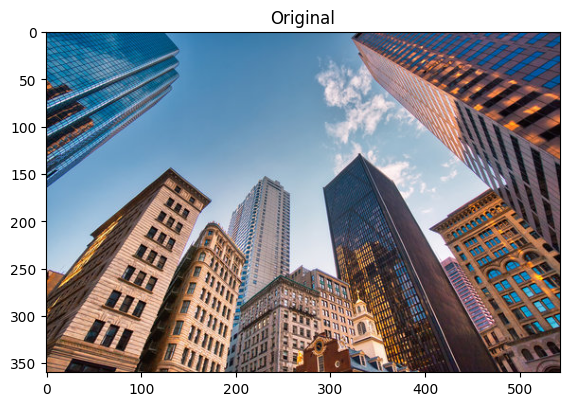

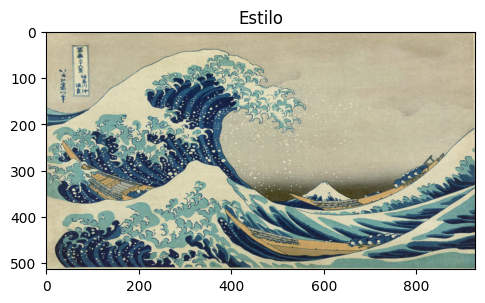

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.040526655..1.0731583].


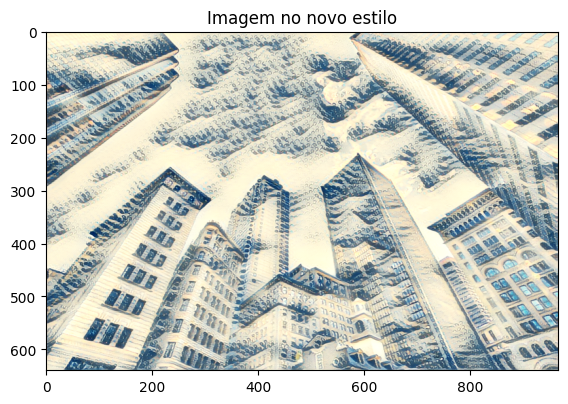

In [4]:
caminho = 'models/ModelsUlyanov/'
caminhoModelos = [f for f in listdir(caminho) if isfile(join(caminho, f))]


imagem = cv2.imread('imagens/cidade.jpg')

for (item, nomeModelo) in enumerate(caminhoModelos):

    print(str(item+1) + " Usando modelo: " + str(nomeModelo)[:-3])

    estilo = cv2.imread('art/'+str(nomeModelo)[:-3]+".jpg")

    modelo = cv2.dnn.readNetFromTorch(caminho+nomeModelo)

    altura, largura = imagem.shape[0], imagem.shape[1]

    novaLargura = int((640/altura) * largura) #Mudando o aspect ratio para a altura fixa de 640

    imagemAlterada = cv2.resize(imagem, (novaLargura, 640), interpolation=cv2.INTER_AREA)

    #criando imagem blob

    """
    A rede foi treinada com imagens normalizadas (valores centrados em zero).
    A subtração remove o "viés" das cores originais, facilitando o aprendizado de padrões.
    """
    blob = cv2.dnn.blobFromImage(imagemAlterada, 1.0, (novaLargura, 640), 
                                 (103.939, 116.779, 123.680), swapRB=False, crop=False)
    
    modelo.setInput(blob)

    saida = modelo.forward()

    #Devido ao parametro mean do blob, a gente vai adicionar de volta os valores e reordenar os canais

    saida = saida.reshape(3, saida.shape[2], saida.shape[3])
    saida[0] += 103.939
    saida[1] += 116.779
    saida[2] += 123.680
    saida /= 255 #Normalizando os valores para [0, 1]

    saida = saida.transpose(1, 2, 0) #Reordenando os canais

    imshow("Original", imagem)
    imshow("Estilo", estilo)
    imshow("Imagem no novo estilo", saida)

In [10]:
#TESTANDO EM VIDEOS

caminhoModelo = 'models/ModelsUlyanov/the_wave.t7'

cap = cv2.VideoCapture('../../videos/PRAIA.mp4')

w = int(cap.get(3))
h = int(cap.get(4))

videoSaida = cv2.VideoWriter('videoPraiaTHEWAVE.mp4', cv2.VideoWriter.fourcc('M', 'P', '4', 'V'), 30, (w, h) )

estilo = cv2.imread('art/the_wave.jpg')

i = 0

while(1):
    ret, frame = cap.read()

    if ret == True:
        i += 1
        print(f'Frames completados: {i}')

        modelo = cv2.dnn.readNetFromTorch(caminhoModelo)

        altura, largura = frame.shape[0], frame.shape[1]

        novaLargura = int((640/altura) * largura) #Mudando o aspect ratio para a altura fixa de 640

        imagemAlterada = cv2.resize(frame, (novaLargura, 640), interpolation=cv2.INTER_AREA)

        #criando imagem blob

        """
        A rede foi treinada com imagens normalizadas (valores centrados em zero).
        A subtração remove o "viés" das cores originais, facilitando o aprendizado de padrões.
        """
        blob = cv2.dnn.blobFromImage(imagemAlterada, 1.0, (novaLargura, 640), 
                                     (103.939, 116.779, 123.680), swapRB=False, crop=False)
        
        modelo.setInput(blob)

        saida = modelo.forward()

        #Devido ao parametro mean do blob, a gente vai adicionar de volta os valores e reordenar os canais

        saida = saida.reshape(3, saida.shape[2], saida.shape[3])
        saida[0] += 103.939
        saida[1] += 116.779
        saida[2] += 123.680

        saida /= 255 #Normalizando os valores para [0, 1]

        saida = saida.transpose(1, 2, 0) #Reordenando os canais

        saidaAlt = (saida * 255).astype('uint8')
        saidaAlt = cv2.resize(saidaAlt, (w, h), interpolation=cv2.INTER_AREA)
        videoSaida.write(saidaAlt)

    else:
        break

cap.release()
videoSaida.release()

Frames completados: 1
Frames completados: 2
Frames completados: 3
Frames completados: 4
Frames completados: 5
Frames completados: 6
Frames completados: 7
Frames completados: 8
Frames completados: 9
Frames completados: 10
Frames completados: 11
Frames completados: 12
Frames completados: 13
Frames completados: 14
Frames completados: 15
Frames completados: 16
Frames completados: 17
Frames completados: 18
Frames completados: 19
Frames completados: 20
Frames completados: 21
Frames completados: 22
Frames completados: 23
Frames completados: 24
Frames completados: 25
Frames completados: 26
Frames completados: 27
Frames completados: 28
Frames completados: 29
Frames completados: 30
Frames completados: 31
Frames completados: 32
Frames completados: 33
Frames completados: 34
Frames completados: 35
Frames completados: 36
Frames completados: 37
Frames completados: 38
Frames completados: 39
Frames completados: 40
Frames completados: 41
Frames completados: 42
Frames completados: 43
Frames completados: 